In [3]:
%cd ..

c:\Users\Maria\OneDrive - UAB\Documentos\3r de IA\Synthesis project II\Code\Layout_Analysis\unilm\layoutlmv3\examples\object_detection


In [4]:
import os

#chage the working directory to the current file
os.chdir("Layout_Analysis/unilm/layoutlmv3/examples/object_detection")

FileNotFoundError: [WinError 3] El sistema no puede encontrar la ruta especificada: 'Layout_Analysis/unilm/layoutlmv3/examples/object_detection'

In [4]:
import os
import itertools

import torch

from typing import Any, Dict, List, Set

from detectron2.data import build_detection_train_loader
from detectron2.checkpoint import DetectionCheckpointer
from detectron2.config import get_cfg
from detectron2.engine import DefaultTrainer, default_argument_parser, default_setup, launch
from detectron2.evaluation import COCOEvaluator
from detectron2.solver.build import maybe_add_gradient_clipping

from ditod import add_vit_config
from ditod import DetrDatasetMapper

from detectron2.data.datasets import register_coco_instances
import logging
from detectron2.utils.logger import setup_logger
from detectron2.utils import comm
from detectron2.engine.defaults import create_ddp_model
import weakref
from detectron2.engine.train_loop import AMPTrainer, SimpleTrainer
from ditod import MyDetectionCheckpointer, ICDAREvaluator
from ditod import MyTrainer
import cv2
from ditod.mytrainer import DefaultPredictor
from detectron2.utils.visualizer import Visualizer
import matplotlib.pyplot as plt


In [5]:
def setup(args):
    """
    Create configs and perform basic setups.
    """
    cfg = get_cfg()
    # add_coat_config(cfg)
    add_vit_config(cfg)
    cfg.merge_from_file(args.config_file)
    cfg.merge_from_list(args.opts)
    cfg.freeze()
    default_setup(cfg, args)
    return cfg

In [8]:
class dotdict(dict):
    """dot.notation access to dictionary attributes"""
    __getattr__ = dict.get
    __setattr__ = dict.__setitem__
    __delattr__ = dict.__delitem__

[03/18 11:39:42 detectron2]: Rank of current process: 0. World size: 1
[03/18 11:39:42 detectron2]: Environment info:
-------------------------------  -------------------------------------------------------------------------------
sys.platform                     win32
Python                           3.8.0 (default, Nov  6 2019, 16:00:02) [MSC v.1916 64 bit (AMD64)]
numpy                            1.24.4
detectron2                       0.6 @c:\users\maria\detectron2\detectron2
Compiler                         MSVC 193532217
CUDA compiler                    not available
DETECTRON2_ENV_MODULE            <not set>
PyTorch                          1.10.0+cpu @c:\Users\Maria\.conda\envs\layoutlmv3\lib\site-packages\torch
PyTorch debug build              False
torch._C._GLIBCXX_USE_CXX11_ABI  False
GPU available                    No: torch.cuda.is_available() == False
Pillow                           10.2.0
torchvision                      0.11.1+cpu @c:\Users\Maria\.conda\envs\layoutlm

c:\Users\Maria\.conda\envs\layoutlmv3\lib\site-packages\torch\nn\functional.py:3631: UserWarning: Default upsampling behavior when mode=bicubic is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  warnings.warn(
c:\Users\Maria\.conda\envs\layoutlmv3\lib\site-packages\torch\nn\functional.py:3631: UserWarning: Default upsampling behavior when mode=bicubic is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  warnings.warn(
c:\Users\Maria\.conda\envs\layoutlmv3\lib\site-packages\torch\nn\functional.py:3631: UserWarning: Default upsampling behavior when mode=bicubic is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  warnings.warn(
c:\Users\Maria\.conda\envs\l

Error processing 0.jpg: 'NoneType' object is not subscriptable
Error processing 1.jpg: 'NoneType' object is not subscriptable
Error processing 0.jpg: 'NoneType' object is not subscriptable
Error processing 1.jpg: 'NoneType' object is not subscriptable


c:\Users\Maria\.conda\envs\layoutlmv3\lib\site-packages\torch\nn\functional.py:3631: UserWarning: Default upsampling behavior when mode=bicubic is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  warnings.warn(
c:\Users\Maria\.conda\envs\layoutlmv3\lib\site-packages\torch\nn\functional.py:3631: UserWarning: Default upsampling behavior when mode=bicubic is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  warnings.warn(
c:\Users\Maria\.conda\envs\layoutlmv3\lib\site-packages\torch\nn\functional.py:3631: UserWarning: Default upsampling behavior when mode=bicubic is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  warnings.warn(
c:\Users\Maria\.conda\envs\l

Error processing 0.jpg: 'NoneType' object is not subscriptable


c:\Users\Maria\.conda\envs\layoutlmv3\lib\site-packages\torch\nn\functional.py:3631: UserWarning: Default upsampling behavior when mode=bicubic is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  warnings.warn(
c:\Users\Maria\.conda\envs\layoutlmv3\lib\site-packages\torch\nn\functional.py:3631: UserWarning: Default upsampling behavior when mode=bicubic is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  warnings.warn(
C:\Users\Maria\AppData\Local\Temp\ipykernel_25084\3238934236.py:39: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using 

Error processing 0.jpg: 'NoneType' object is not subscriptable
Error processing 1.jpg: 'NoneType' object is not subscriptable


c:\Users\Maria\.conda\envs\layoutlmv3\lib\site-packages\torch\nn\functional.py:3631: UserWarning: Default upsampling behavior when mode=bicubic is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  warnings.warn(


Error processing 0.jpg: 'NoneType' object is not subscriptable


c:\Users\Maria\.conda\envs\layoutlmv3\lib\site-packages\torch\nn\functional.py:3631: UserWarning: Default upsampling behavior when mode=bicubic is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  warnings.warn(


Error processing 0.jpg: 'NoneType' object is not subscriptable
Error processing 1.jpg: 'NoneType' object is not subscriptable
Error processing 0.jpg: 'NoneType' object is not subscriptable
Error processing 1.jpg: 'NoneType' object is not subscriptable
Error processing 0.jpg: 'NoneType' object is not subscriptable
Error processing 1.jpg: 'NoneType' object is not subscriptable
Error processing 0.jpg: 'NoneType' object is not subscriptable
Error processing 1.jpg: 'NoneType' object is not subscriptable
Error processing 2.jpg: 'NoneType' object is not subscriptable
Error processing 0.jpg: 'NoneType' object is not subscriptable
Error processing 1.jpg: 'NoneType' object is not subscriptable
Error processing 0.jpg: 'NoneType' object is not subscriptable
Error processing 1.jpg: 'NoneType' object is not subscriptable
Error processing 2.jpg: 'NoneType' object is not subscriptable
Error processing 0.jpg: 'NoneType' object is not subscriptable
Error processing 0.jpg: 'NoneType' object is not subscr

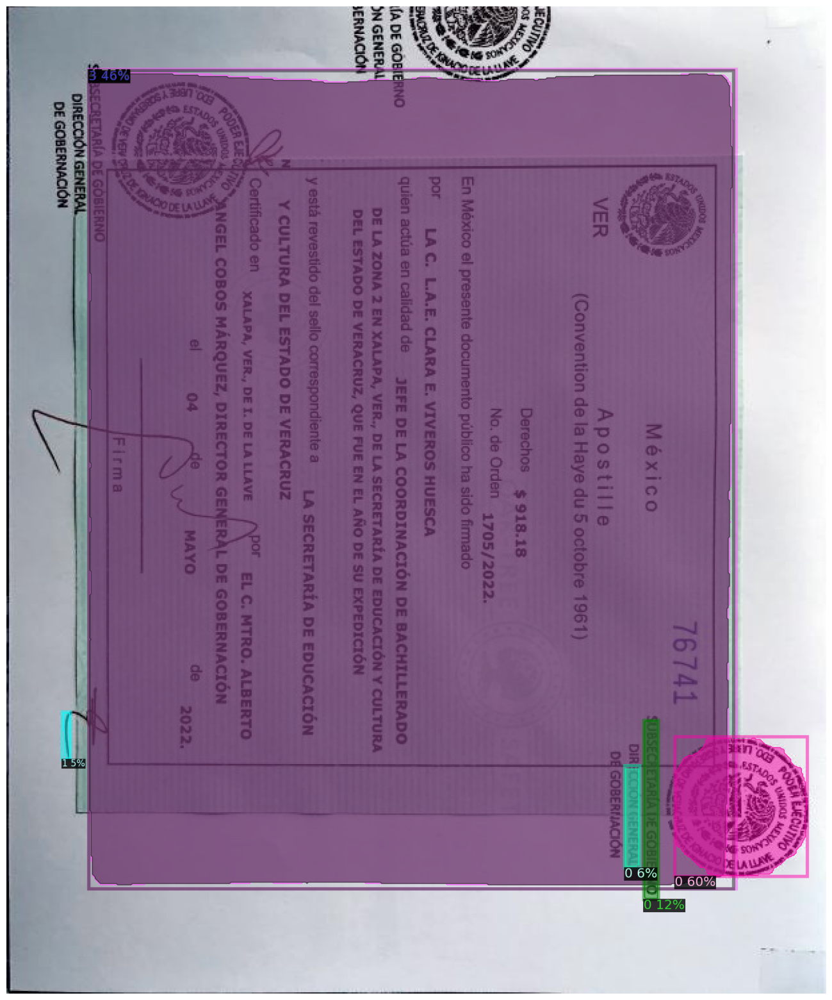

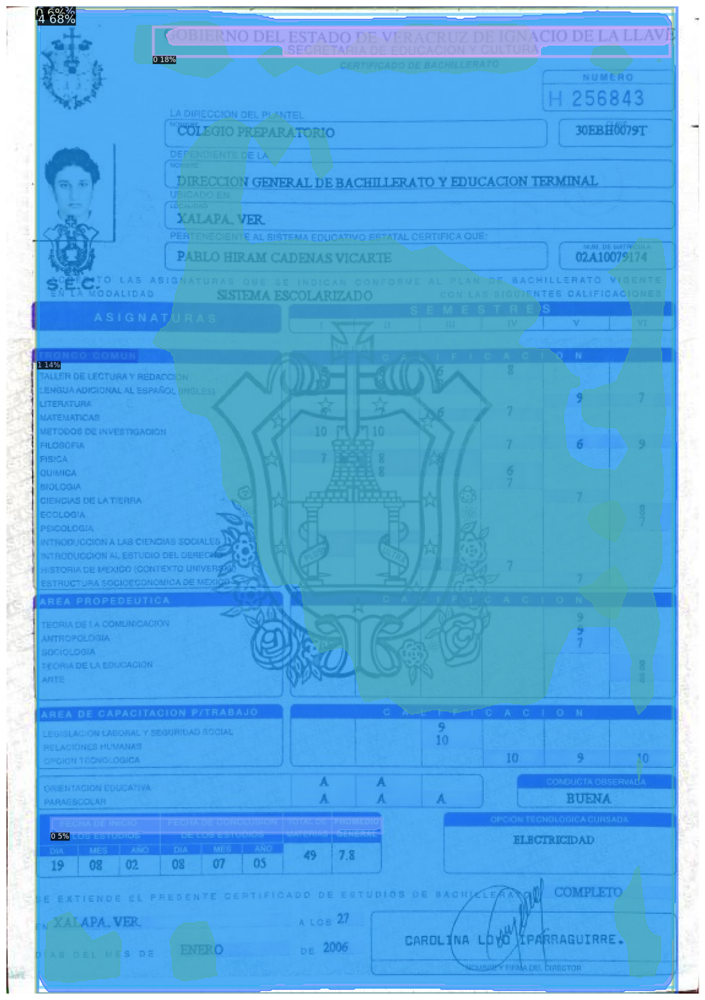

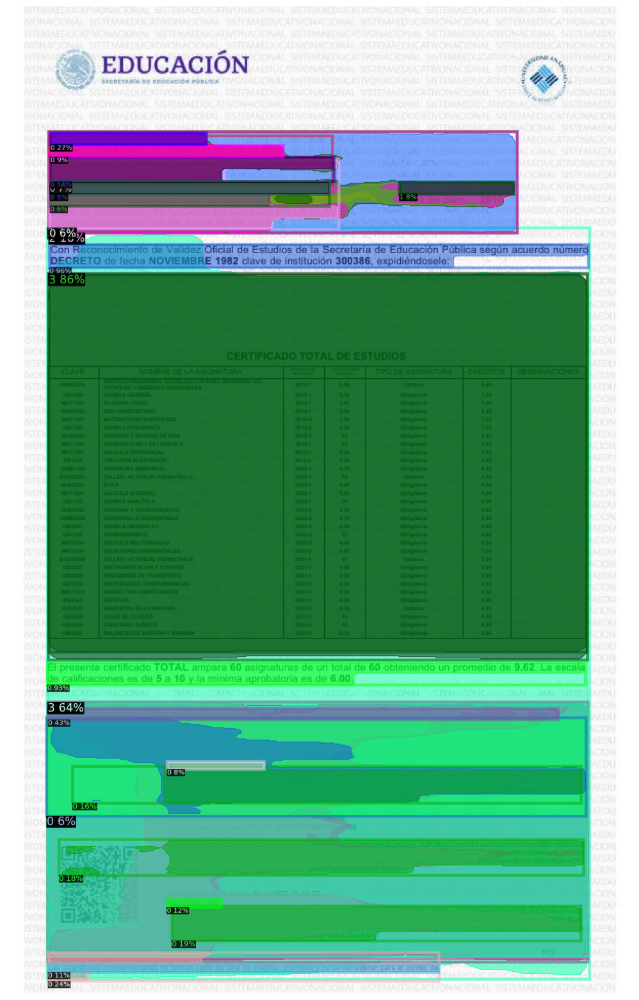

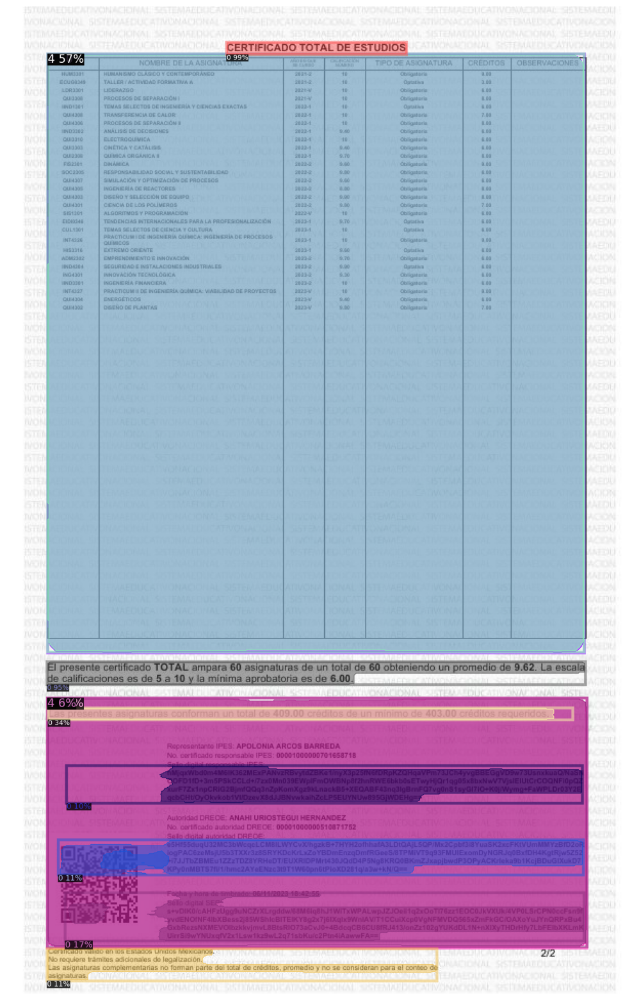

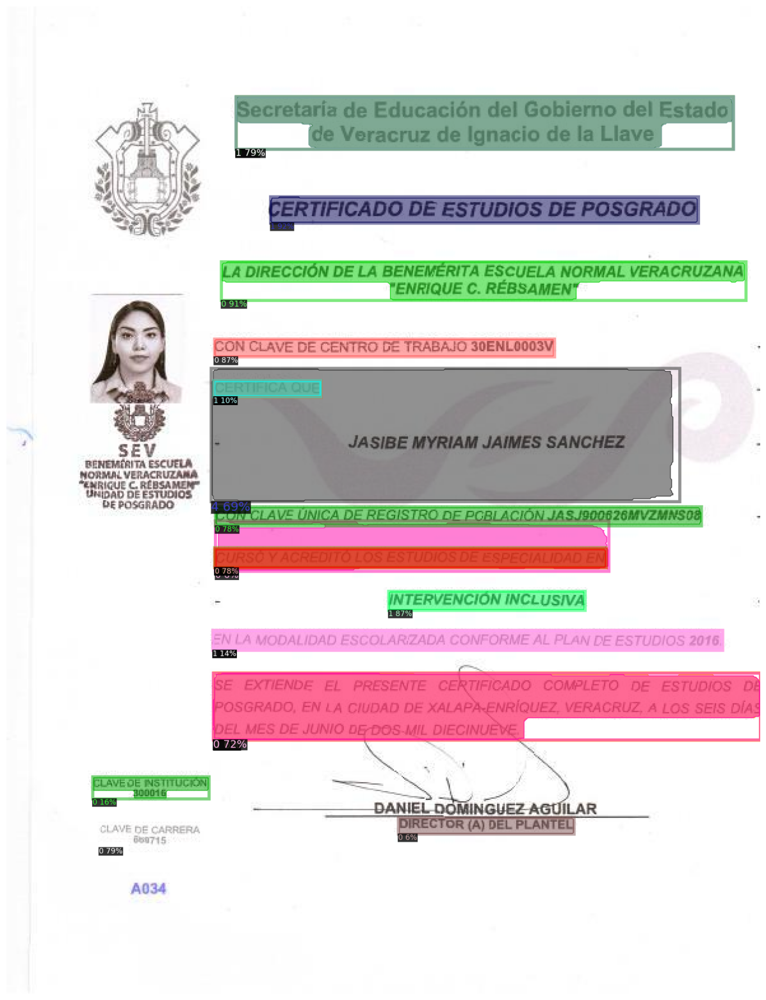

...

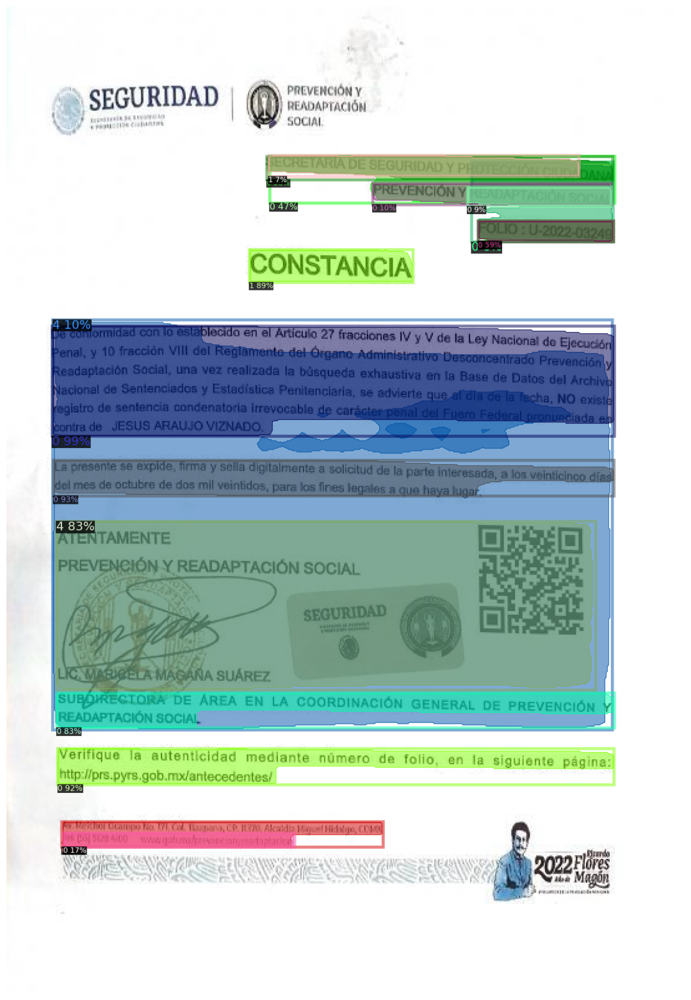

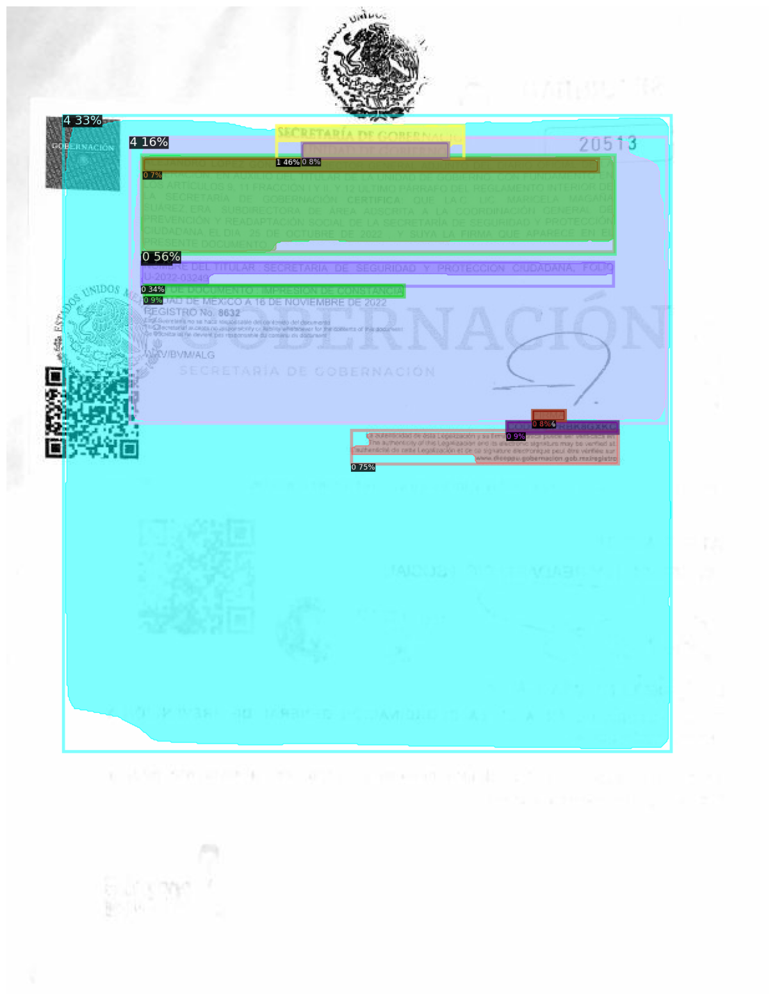

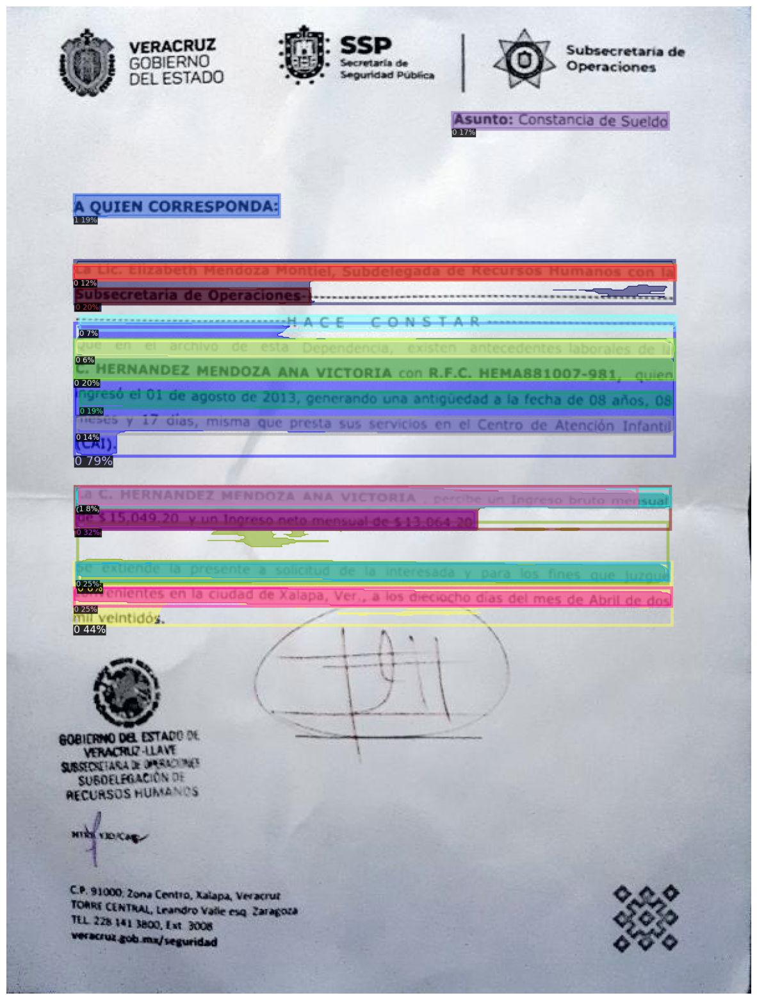

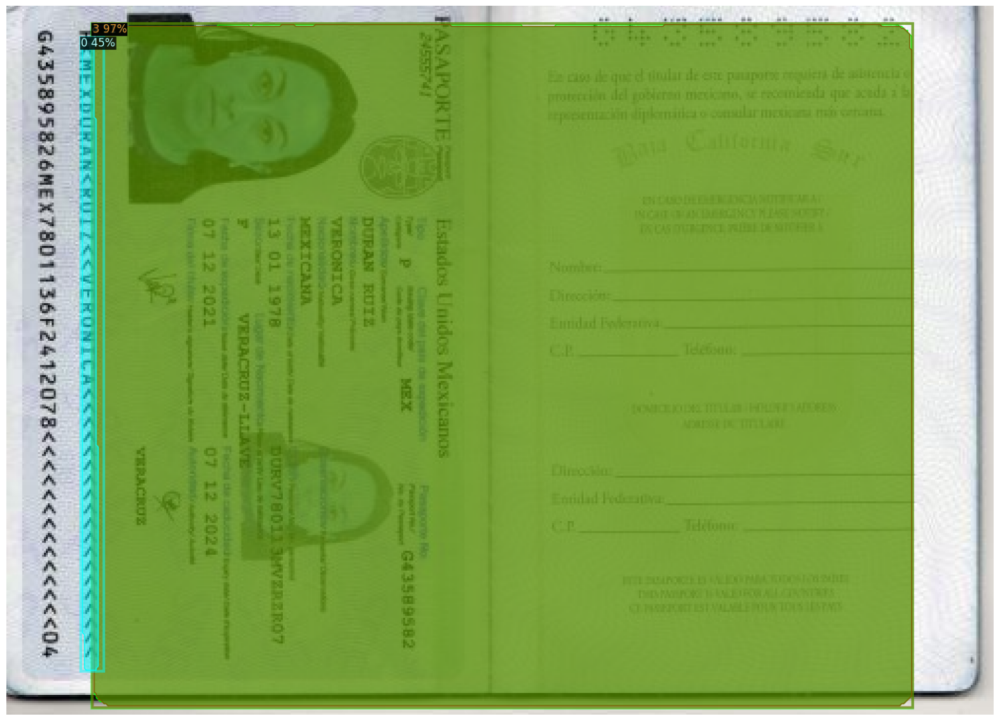

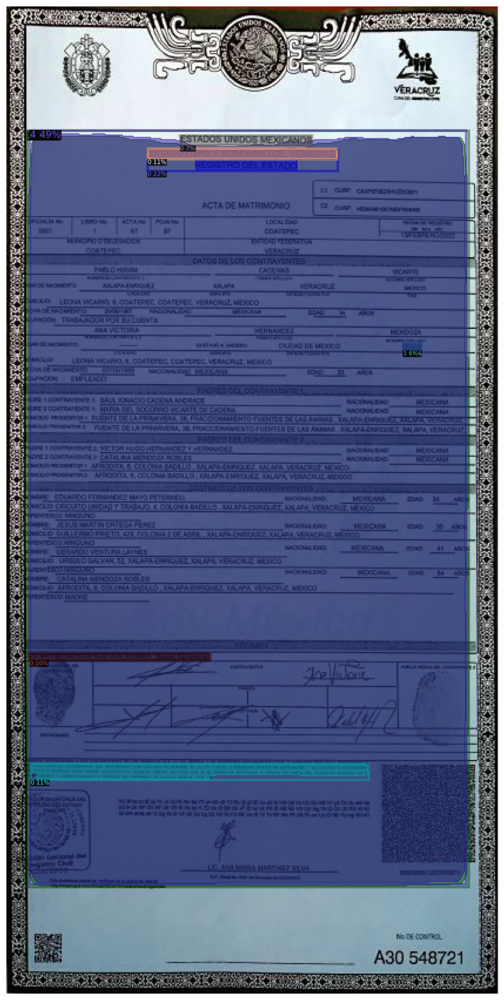

In [11]:
# parser = default_argument_parser()
# parser.add_argument("--debug", action="store_true", help="enable debug mode")
# args = parser.parse_args()
# print("Command Line Args:", args)

# Namespace(config_file='cascade_layoutlmv3.yaml', debug=False, dist_url='tcp://127.0.0.1:49153', eval_only=True, machine_rank=0, num_gpus=0, num_machines=1, opts=['MODEL.WEIGHTS', 'checkpoint/model_final.pth', 'OUTPUT_DIR', './output/'], resume=False)
args = dotdict()
args["epilog"] = f""
args["config_file"] = "cascade_layoutlmv3.yaml"
args["debug"] = False
args["dist_url"] = "tcp://127.0.0.1:49153"
args["eval_only"] = True
args["machine_rank"] = 0
args["num_gpus"] = 0
args["num_machines"] = 1
args["opts"] = ['MODEL.WEIGHTS', 'publaynet/model_final.pth', 'OUTPUT_DIR', './output/']
args["resume"] = False


cfg = setup(args)
pred = DefaultPredictor(cfg)
    
root_folder = "C:/Users/Maria/OneDrive - UAB/Documentos/3r de IA/Synthesis project II/Sample documents - JPG"
output_folder = "/Sample documents - layoutlmv3_pretr_publaynet"

for root, dirs, files in os.walk(root_folder):  
    for file in files:
        try:
            inputs = cv2.imread(os.path.join(root, file))
            outputs = pred(inputs)    
            
            v = Visualizer(inputs[:, :, ::-1], scale=3)
            out = v.draw_instance_predictions(outputs["instances"].to("cpu"))

            output_root = root.replace("Sample documents - JPG", output_folder)
            os.makedirs(output_root, exist_ok=True)
            
            #make the plot bigger
            plt.figure(figsize=(20, 20))
            plt.axis('off')
            plt.imshow(out.get_image()[:, :, ::-1])
            # plt.show()
            plt.imsave(os.path.join(output_root, file), out.get_image()[:, :, ::-1])
        except Exception as e:
            print(f"Error processing {file}: {e}")